In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
import re


In [6]:
df = pd.read_csv("/Users/apple/Downloads/adult.csv")

In [7]:
df.head()

,age,workclass,fnlwgt,education,education.num,marital.status,occupation,relationship,race,sex,capital.gain,capital.loss,hours.per.week,native.country,income
0,90,?,77053,HS-grad,9,Widowed,?,Not-in-family,White,Female,0,4356,40,United-States,<=50K
1,82,Private,132870,HS-grad,9,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,<=50K
2,66,?,186061,Some-college,10,Widowed,?,Unmarried,Black,Female,0,4356,40,United-States,<=50K
3,54,Private,140359,7th-8th,4,Divorced,Machine-op-inspct,Unmarried,White,Female,0,3900,40,United-States,<=50K
4,41,Private,264663,Some-college,10,Separated,Prof-specialty,Own-child,White,Female,0,3900,40,United-States,<=50K


In [8]:
df.shape

(32561, 15)

In [9]:
df.isna().sum()

age               0
workclass         0
fnlwgt            0
education         0
education.num     0
marital.status    0
occupation        0
relationship      0
race              0
sex               0
capital.gain      0
capital.loss      0
hours.per.week    0
native.country    0
income            0
dtype: int64

In [10]:
df.isnull().sum()

age               0
workclass         0
fnlwgt            0
education         0
education.num     0
marital.status    0
occupation        0
relationship      0
race              0
sex               0
capital.gain      0
capital.loss      0
hours.per.week    0
native.country    0
income            0
dtype: int64

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32561 non-null  int64 
 1   workclass       32561 non-null  object
 2   fnlwgt          32561 non-null  int64 
 3   education       32561 non-null  object
 4   education.num   32561 non-null  int64 
 5   marital.status  32561 non-null  object
 6   occupation      32561 non-null  object
 7   relationship    32561 non-null  object
 8   race            32561 non-null  object
 9   sex             32561 non-null  object
 10  capital.gain    32561 non-null  int64 
 11  capital.loss    32561 non-null  int64 
 12  hours.per.week  32561 non-null  int64 
 13  native.country  32561 non-null  object
 14  income          32561 non-null  object
dtypes: int64(6), object(9)
memory usage: 3.7+ MB


In [12]:
special_char_pattern = re.compile(r'[^\w\s]',re.IGNORECASE)

In [13]:
def contain_special_chars(s):
    return bool(special_char_pattern.search(str(s)))

In [14]:
mask = df.applymap(contain_special_chars)

In [15]:
rows_with_special_chars = df[mask.any(axis=1)]

In [16]:
rows_with_special_chars

,age,workclass,fnlwgt,education,education.num,marital.status,occupation,relationship,race,sex,capital.gain,capital.loss,hours.per.week,native.country,income
0,90,?,77053,HS-grad,9,Widowed,?,Not-in-family,White,Female,0,4356,40,United-States,<=50K
1,82,Private,132870,HS-grad,9,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,<=50K
2,66,?,186061,Some-college,10,Widowed,?,Unmarried,Black,Female,0,4356,40,United-States,<=50K
3,54,Private,140359,7th-8th,4,Divorced,Machine-op-inspct,Unmarried,White,Female,0,3900,40,United-States,<=50K
4,41,Private,264663,Some-college,10,Separated,Prof-specialty,Own-child,White,Female,0,3900,40,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,22,Private,310152,Some-college,10,Never-married,Protective-serv,Not-in-family,White,Male,0,0,40,United-States,<=50K
32557,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
32558,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
32559,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K


In [17]:
col_with_special_chars = df.loc[:,mask.any(axis=0)]

In [18]:
col_with_special_chars

,workclass,education,marital.status,occupation,relationship,race,native.country,income
0,?,HS-grad,Widowed,?,Not-in-family,White,United-States,<=50K
1,Private,HS-grad,Widowed,Exec-managerial,Not-in-family,White,United-States,<=50K
2,?,Some-college,Widowed,?,Unmarried,Black,United-States,<=50K
3,Private,7th-8th,Divorced,Machine-op-inspct,Unmarried,White,United-States,<=50K
4,Private,Some-college,Separated,Prof-specialty,Own-child,White,United-States,<=50K
...,...,...,...,...,...,...,...,...
32556,Private,Some-college,Never-married,Protective-serv,Not-in-family,White,United-States,<=50K
32557,Private,Assoc-acdm,Married-civ-spouse,Tech-support,Wife,White,United-States,<=50K
32558,Private,HS-grad,Married-civ-spouse,Machine-op-inspct,Husband,White,United-States,>50K
32559,Private,HS-grad,Widowed,Adm-clerical,Unmarried,White,United-States,<=50K


In [19]:
def highlight_special_chars(val):
    if contain_special_chars(val):
        return 'background-color: yellow'
    return ''

In [20]:

styled_df = df.style.applymap(highlight_special_chars)
display(styled_df)

In [21]:
df.columns

Index(['age', 'workclass', 'fnlwgt', 'education', 'education.num',
       'marital.status', 'occupation', 'relationship', 'race', 'sex',
       'capital.gain', 'capital.loss', 'hours.per.week', 'native.country',
       'income'],
      dtype='object')

In [22]:
df.dtypes

age                int64
workclass         object
fnlwgt             int64
education         object
education.num      int64
marital.status    object
occupation        object
relationship      object
race              object
sex               object
capital.gain       int64
capital.loss       int64
hours.per.week     int64
native.country    object
income            object
dtype: object

In [23]:
#CHECK THE DUPLICATE VALUE IN DATASET
df.duplicated().sum()

np.int64(24)

In [24]:
#Drop the duplicate vales from the data
df.drop_duplicates(inplace=True)

In [25]:
df.shape

(32537, 15)

In [26]:
df.describe()

,age,fnlwgt,education.num,capital.gain,capital.loss,hours.per.week
count,32537.000000,3.253700e+04,32537.000000,32537.000000,32537.000000,32537.000000
mean,38.585549,1.897808e+05,10.081815,1078.443741,87.368227,40.440329
std,13.637984,1.055565e+05,2.571633,7387.957424,403.101833,12.346889
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.178270e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.783560e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.369930e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.484705e+06,16.000000,99999.000000,4356.000000,99.000000


In [27]:
#separate categorcial columns and numerical columns
numerical_cols = df.select_dtypes(include="int").columns

In [28]:
numerical_cols

Index(['age', 'fnlwgt', 'education.num', 'capital.gain', 'capital.loss',
       'hours.per.week'],
      dtype='object')

In [29]:
categorical_cols = df.select_dtypes(include="object").columns

In [30]:
categorical_cols

Index(['workclass', 'education', 'marital.status', 'occupation',
       'relationship', 'race', 'sex', 'native.country', 'income'],
      dtype='object')

In [31]:
df["workclass"].value_counts()

workclass
Private             22673
Self-emp-not-inc     2540
Local-gov            2093
?                    1836
State-gov            1298
Self-emp-inc         1116
Federal-gov           960
Without-pay            14
Never-worked            7
Name: count, dtype: int64

In [32]:
for i in categorical_cols:
    print(i,df[i].unique())

    print()
    print("************ Sperated columns *****************")
    print()

workclass ['?' 'Private' 'State-gov' 'Federal-gov' 'Self-emp-not-inc' 'Self-emp-inc'
 'Local-gov' 'Without-pay' 'Never-worked']

************ Sperated columns *****************

education ['HS-grad' 'Some-college' '7th-8th' '10th' 'Doctorate' 'Prof-school'
 'Bachelors' 'Masters' '11th' 'Assoc-acdm' 'Assoc-voc' '1st-4th' '5th-6th'
 '12th' '9th' 'Preschool']

************ Sperated columns *****************

marital.status ['Widowed' 'Divorced' 'Separated' 'Never-married' 'Married-civ-spouse'
 'Married-spouse-absent' 'Married-AF-spouse']

************ Sperated columns *****************

occupation ['?' 'Exec-managerial' 'Machine-op-inspct' 'Prof-specialty'
 'Other-service' 'Adm-clerical' 'Craft-repair' 'Transport-moving'
 'Handlers-cleaners' 'Sales' 'Farming-fishing' 'Tech-support'
 'Protective-serv' 'Armed-Forces' 'Priv-house-serv']

************ Sperated columns *****************

relationship ['Not-in-family' 'Unmarried' 'Own-child' 'Other-relative' 'Husband' 'Wife']

************ Sper

In [33]:
for i in numerical_cols:
    print(i,df[i].unique())

    print()
    print("***********Sperated columns ************")
    print()

age [90 82 66 54 41 34 38 74 68 45 52 32 51 46 57 22 37 29 61 21 33 49 23 59
 60 63 53 44 43 71 48 73 67 40 50 42 39 55 47 31 58 62 36 72 78 83 26 70
 27 35 81 65 25 28 56 69 20 30 24 64 75 19 77 80 18 17 76 79 88 84 85 86
 87]

***********Sperated columns ************

fnlwgt [ 77053 132870 186061 ...  34066  84661 257302]

***********Sperated columns ************

education.num [ 9 10  4  6 16 15 13 14  7 12 11  2  3  8  5  1]

***********Sperated columns ************

capital.gain [    0 99999 41310 34095 27828 25236 25124 22040 20051 18481 15831 15024
 15020 14344 14084 13550 11678 10605 10566 10520  9562  9386  8614  7978
  7896  7688  7443  7430  7298  6849  6767  6723  6514  6497  6418  6360
  6097  5721  5556  5455  5178  5060  5013  4934  4931  4865  4787  4687
  4650  4508  4416  4386  4101  4064  3942  3908  3887  3818  3781  3674
  3471  3464  3456  3432  3418  3411  3325  3273  3137  3103  2993  2977
  2964  2961  2936  2907  2885  2829  2653  2635  2597  2580  2538  2463


In [34]:
#remove ? and replace with mode value mode()
df['workclass'] = df["workclass"].replace("?","Private")
df["occupation"] = df["occupation"].replace("?","Prof-specialty")
df["native.country"] = df["native.country"].replace("?","United-States")


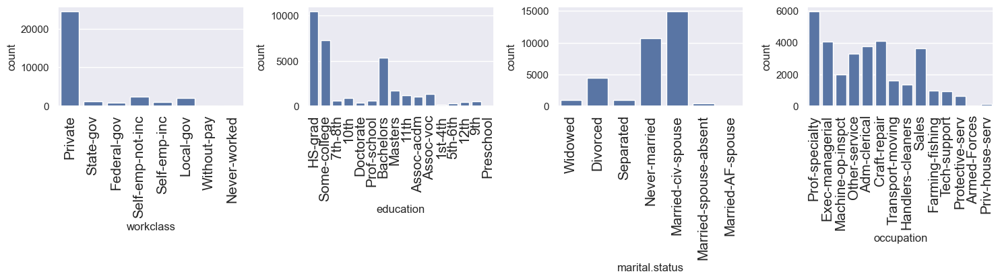

In [36]:
plt.style.use("fivethirtyeight")
sns.set(rc={"figure.figsize":(15,6)})
columns1 = ["workclass","education","marital.status","occupation"]
for i in range(0,len(columns1)):
    plt.subplot(2,4,i+1)
    sns.countplot(x=df[columns1[i]])
    plt.xticks(size=15,rotation=90)
    plt.tight_layout()

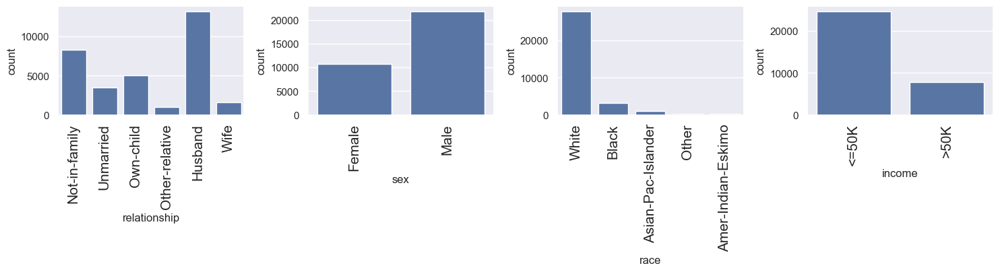

In [37]:
columns2 = ["relationship","sex","race","income"]
for i in range(0,len(columns2)):
    plt.subplot(2,4,i+1)
    sns.countplot(x=df[columns2[i]])
    plt.xticks(size=15,rotation=90)
    plt.tight_layout()
    

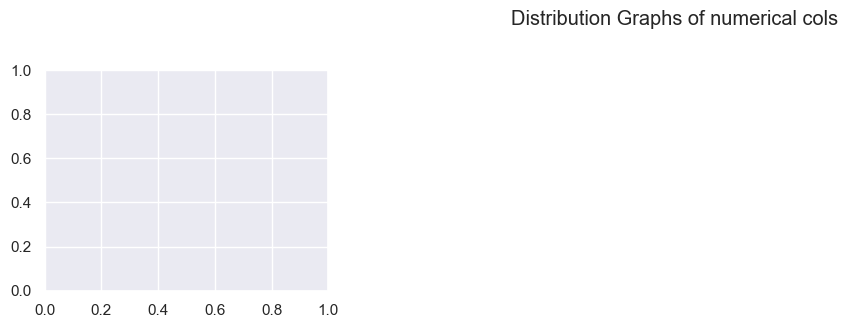

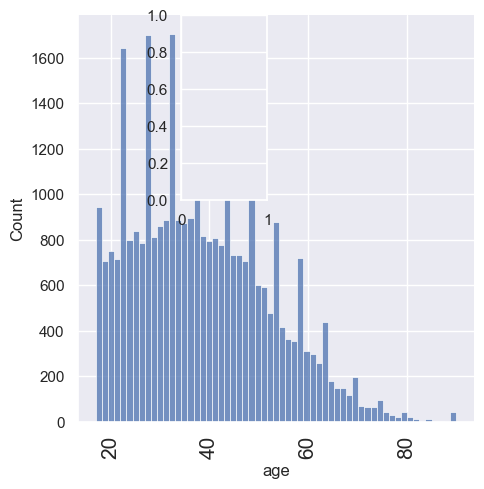

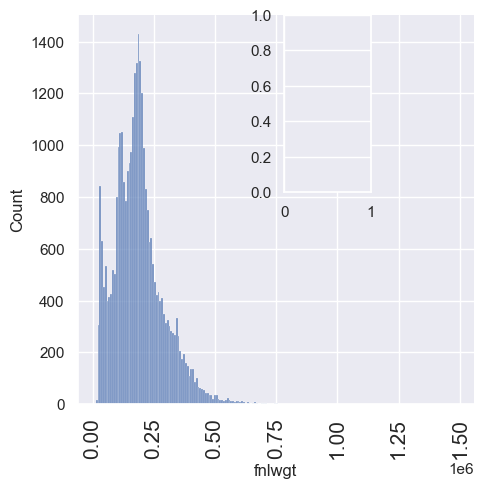

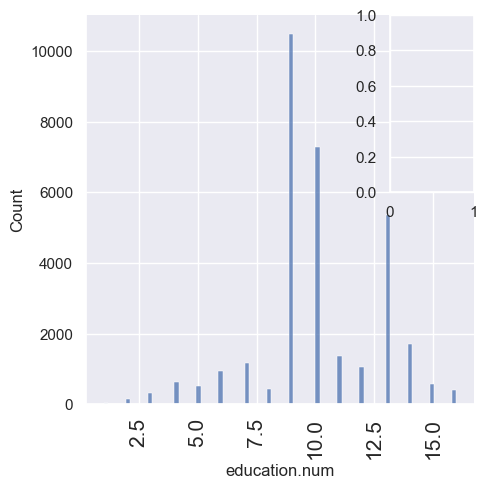

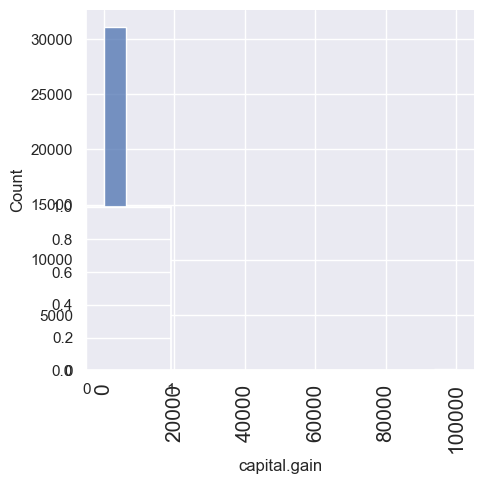

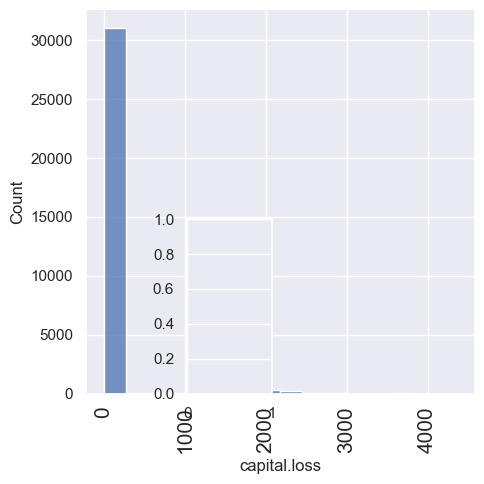

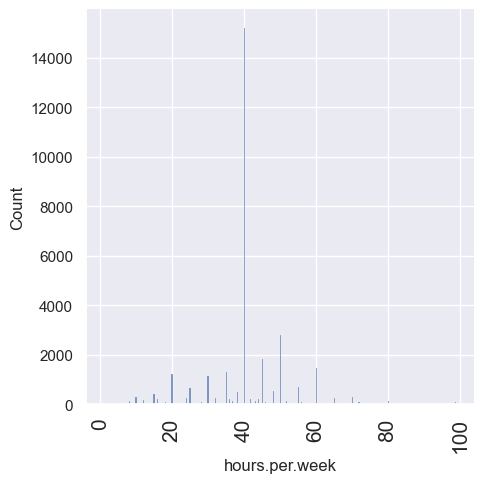

In [38]:
plt.suptitle("Distribution Graphs of numerical cols")
for i in range(0,len(numerical_cols)):
    plt.subplot(2,4,i+1)
    sns.displot(x=df[numerical_cols[i]])
    plt.xticks(size=15,rotation=90)
    plt.tight_layout()

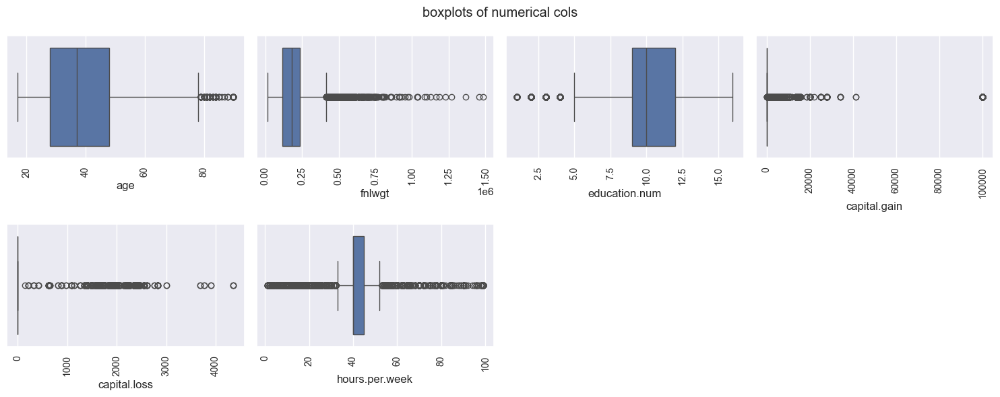

In [39]:
plt.suptitle("boxplots of numerical cols")
for i in range(0,len(numerical_cols)):
    plt.subplot(2,4,i+1)
    sns.boxplot(x=df[numerical_cols[i]])
    plt.xticks(size=10,rotation=90)
    plt.tight_layout()

In [40]:
df = df.rename(columns={"marital.status":"marital_status","education.num":"education_num","capital.gain":"capital_gain","capital.loss":"capital_loss","native.country":"native_country","hours.per.week":"hours_per_week"})

In [41]:
df.head()

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,90,Private,77053,HS-grad,9,Widowed,Prof-specialty,Not-in-family,White,Female,0,4356,40,United-States,<=50K
1,82,Private,132870,HS-grad,9,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,<=50K
2,66,Private,186061,Some-college,10,Widowed,Prof-specialty,Unmarried,Black,Female,0,4356,40,United-States,<=50K
3,54,Private,140359,7th-8th,4,Divorced,Machine-op-inspct,Unmarried,White,Female,0,3900,40,United-States,<=50K
4,41,Private,264663,Some-college,10,Separated,Prof-specialty,Own-child,White,Female,0,3900,40,United-States,<=50K


In [42]:
df

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,90,Private,77053,HS-grad,9,Widowed,Prof-specialty,Not-in-family,White,Female,0,4356,40,United-States,<=50K
1,82,Private,132870,HS-grad,9,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,<=50K
2,66,Private,186061,Some-college,10,Widowed,Prof-specialty,Unmarried,Black,Female,0,4356,40,United-States,<=50K
3,54,Private,140359,7th-8th,4,Divorced,Machine-op-inspct,Unmarried,White,Female,0,3900,40,United-States,<=50K
4,41,Private,264663,Some-college,10,Separated,Prof-specialty,Own-child,White,Female,0,3900,40,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,22,Private,310152,Some-college,10,Never-married,Protective-serv,Not-in-family,White,Male,0,0,40,United-States,<=50K
32557,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
32558,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
32559,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K


In [43]:
salary = pd.crosstab(df["income"],df["workclass"])

In [44]:
categorical_cols

Index(['workclass', 'education', 'marital.status', 'occupation',
       'relationship', 'race', 'sex', 'native.country', 'income'],
      dtype='object')

<Axes: xlabel='income'>

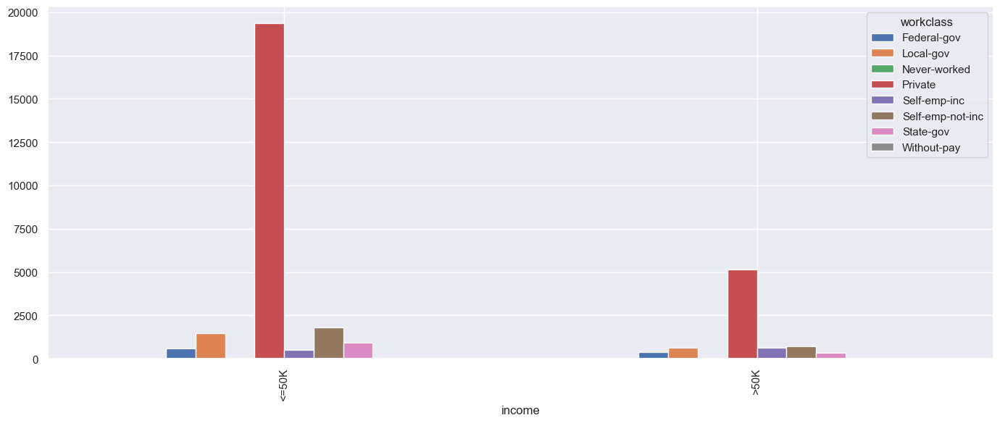

In [45]:
salary = pd.crosstab(df["income"],df["workclass"])
salary.plot(kind="bar")

<Axes: xlabel='income'>

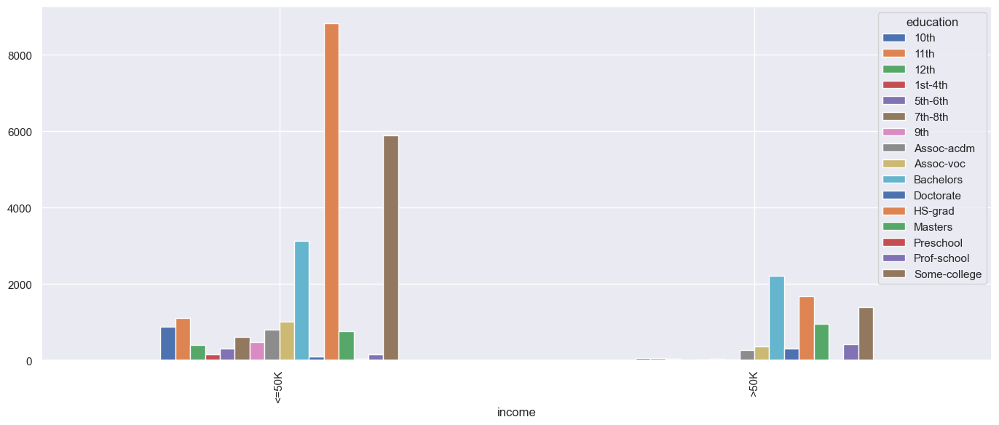

In [46]:
education = pd.crosstab(df["income"],df["education"])
education.plot(kind="bar")

<Axes: xlabel='income'>

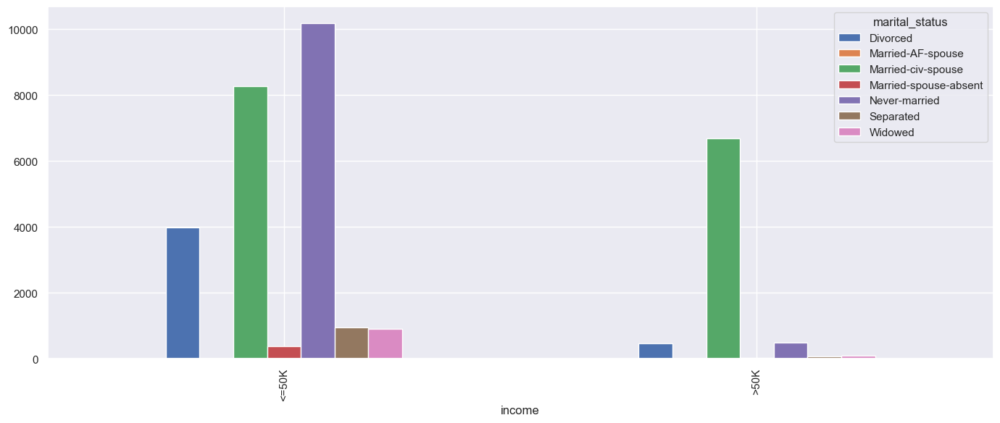

In [47]:
marital = pd.crosstab(df["income"],df["marital_status"])
marital.plot(kind="bar")

<Axes: xlabel='income'>

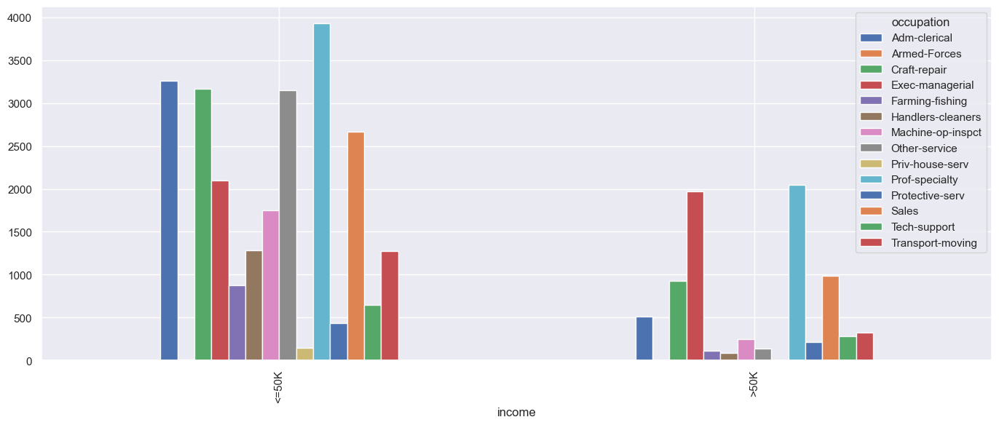

In [48]:
occupation = pd.crosstab(df["income"],df["occupation"])
occupation.plot(kind="bar")

<Axes: xlabel='income'>

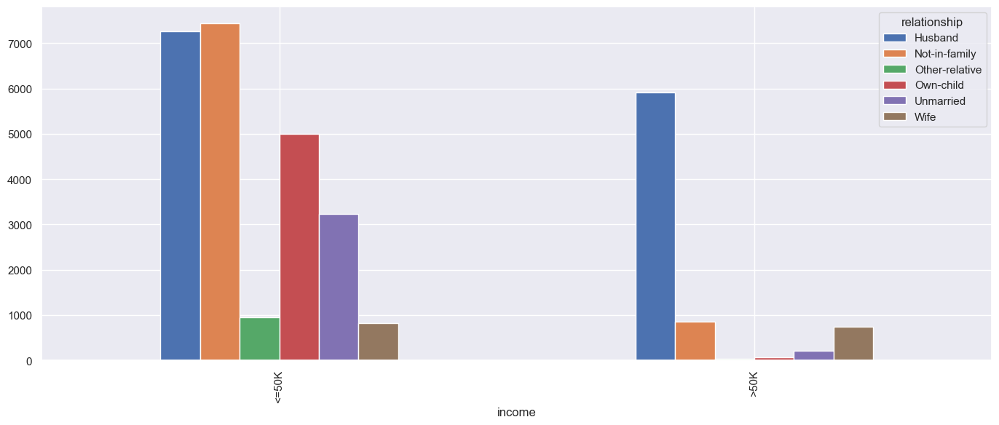

In [49]:
relationship = pd.crosstab(df["income"],df["relationship"])
relationship.plot(kind="bar")

<Axes: xlabel='income'>

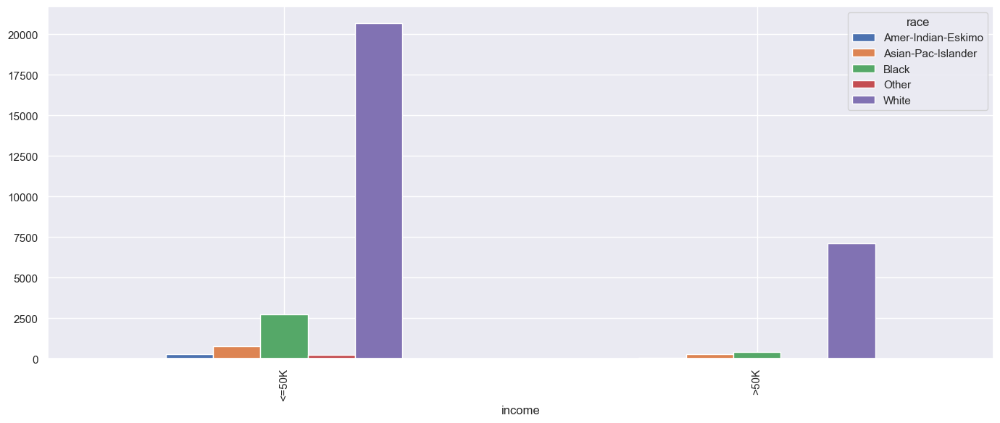

In [50]:
race = pd.crosstab(df["income"],df["race"])
race.plot(kind="bar")

<Axes: xlabel='income'>

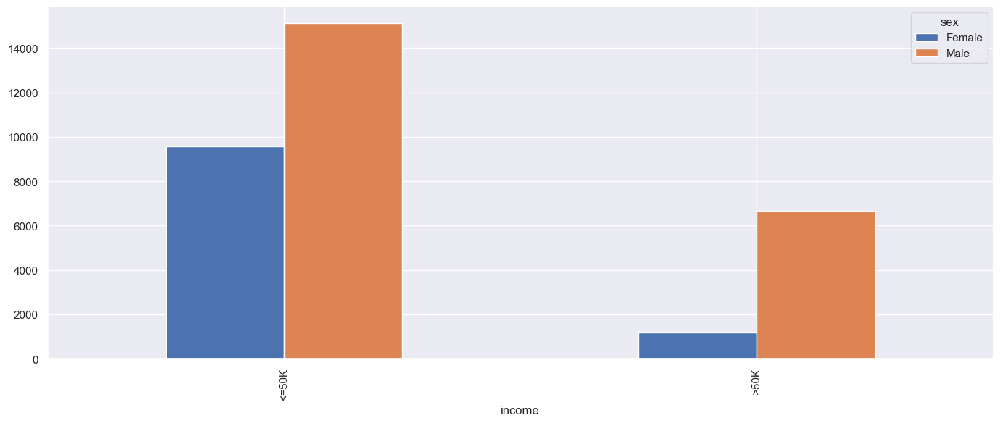

In [403]:
sex = pd.crosstab(df["income"],df["sex"])
sex.plot(kind="bar")

In [51]:
df

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,90,Private,77053,HS-grad,9,Widowed,Prof-specialty,Not-in-family,White,Female,0,4356,40,United-States,<=50K
1,82,Private,132870,HS-grad,9,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,<=50K
2,66,Private,186061,Some-college,10,Widowed,Prof-specialty,Unmarried,Black,Female,0,4356,40,United-States,<=50K
3,54,Private,140359,7th-8th,4,Divorced,Machine-op-inspct,Unmarried,White,Female,0,3900,40,United-States,<=50K
4,41,Private,264663,Some-college,10,Separated,Prof-specialty,Own-child,White,Female,0,3900,40,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,22,Private,310152,Some-college,10,Never-married,Protective-serv,Not-in-family,White,Male,0,0,40,United-States,<=50K
32557,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
32558,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
32559,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K


In [52]:
from sklearn.preprocessing import LabelEncoder 
#create a LabelEncoder object 
le = LabelEncoder()
#define categorical_cols 
categorical_cols =['workclass','education', 'marital_status', 'occupation',
       'relationship', 'race', 'sex', 'native_country']

for feature in categorical_cols:
    le.fit(df[feature])
    df[feature] = le.transform(df[feature])

In [53]:
categorical_cols

['workclass',
 'education',
 'marital_status',
 'occupation',
 'relationship',
 'race',
 'sex',
 'native_country']

In [54]:
df

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,90,3,77053,11,9,6,9,1,4,0,0,4356,40,38,<=50K
1,82,3,132870,11,9,6,3,1,4,0,0,4356,18,38,<=50K
2,66,3,186061,15,10,6,9,4,2,0,0,4356,40,38,<=50K
3,54,3,140359,5,4,0,6,4,4,0,0,3900,40,38,<=50K
4,41,3,264663,15,10,5,9,3,4,0,0,3900,40,38,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,22,3,310152,15,10,4,10,1,4,1,0,0,40,38,<=50K
32557,27,3,257302,7,12,2,12,5,4,0,0,0,38,38,<=50K
32558,40,3,154374,11,9,2,6,0,4,1,0,0,40,38,>50K
32559,58,3,151910,11,9,6,0,4,4,0,0,0,40,38,<=50K


In [55]:
df["income"].unique()

array(['<=50K', '>50K'], dtype=object)

In [56]:
df["income"] =df["income"].str.strip().str.lower()

In [57]:
df["income"]

0        <=50k
1        <=50k
2        <=50k
3        <=50k
4        <=50k
         ...  
32556    <=50k
32557    <=50k
32558     >50k
32559    <=50k
32560    <=50k
Name: income, Length: 32537, dtype: object

In [58]:
mapping = {"<=50k":0,">50k":1}

In [59]:
df["income"].map(mapping)

0        0
1        0
2        0
3        0
4        0
        ..
32556    0
32557    0
32558    1
32559    0
32560    0
Name: income, Length: 32537, dtype: int64

In [60]:
df["income"] = df["income"].map(mapping)

In [61]:
df["income"]

0        0
1        0
2        0
3        0
4        0
        ..
32556    0
32557    0
32558    1
32559    0
32560    0
Name: income, Length: 32537, dtype: int64

In [62]:
df

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,90,3,77053,11,9,6,9,1,4,0,0,4356,40,38,0
1,82,3,132870,11,9,6,3,1,4,0,0,4356,18,38,0
2,66,3,186061,15,10,6,9,4,2,0,0,4356,40,38,0
3,54,3,140359,5,4,0,6,4,4,0,0,3900,40,38,0
4,41,3,264663,15,10,5,9,3,4,0,0,3900,40,38,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,22,3,310152,15,10,4,10,1,4,1,0,0,40,38,0
32557,27,3,257302,7,12,2,12,5,4,0,0,0,38,38,0
32558,40,3,154374,11,9,2,6,0,4,1,0,0,40,38,1
32559,58,3,151910,11,9,6,0,4,4,0,0,0,40,38,0


In [441]:
df["income"].value_counts().sum()

32537

<Axes: >

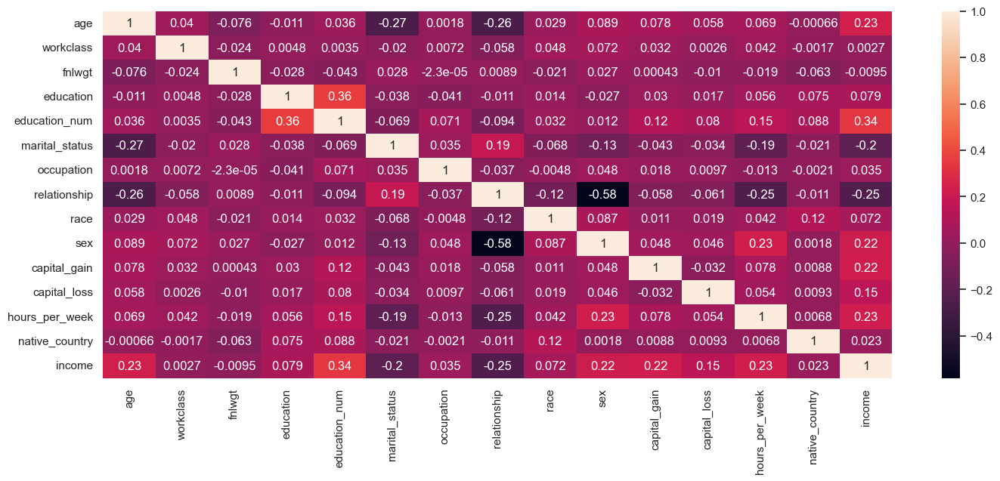

In [63]:
sns.heatmap(df.corr(),annot=True)

In [64]:
df["income"].value_counts()

income
0    24698
1     7839
Name: count, dtype: int64

In [65]:
df

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,90,3,77053,11,9,6,9,1,4,0,0,4356,40,38,0
1,82,3,132870,11,9,6,3,1,4,0,0,4356,18,38,0
2,66,3,186061,15,10,6,9,4,2,0,0,4356,40,38,0
3,54,3,140359,5,4,0,6,4,4,0,0,3900,40,38,0
4,41,3,264663,15,10,5,9,3,4,0,0,3900,40,38,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,22,3,310152,15,10,4,10,1,4,1,0,0,40,38,0
32557,27,3,257302,7,12,2,12,5,4,0,0,0,38,38,0
32558,40,3,154374,11,9,2,6,0,4,1,0,0,40,38,1
32559,58,3,151910,11,9,6,0,4,4,0,0,0,40,38,0


In [66]:
#droppping the education_num and fnlwagt and native_country 
df.drop(["education_num","fnlwgt","native_country"],axis=1,inplace=True)

In [67]:
df

,age,workclass,education,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,income
0,90,3,11,6,9,1,4,0,0,4356,40,0
1,82,3,11,6,3,1,4,0,0,4356,18,0
2,66,3,15,6,9,4,2,0,0,4356,40,0
3,54,3,5,0,6,4,4,0,0,3900,40,0
4,41,3,15,5,9,3,4,0,0,3900,40,0
...,...,...,...,...,...,...,...,...,...,...,...,...
32556,22,3,15,4,10,1,4,1,0,0,40,0
32557,27,3,7,2,12,5,4,0,0,0,38,0
32558,40,3,11,2,6,0,4,1,0,0,40,1
32559,58,3,11,6,0,4,4,0,0,0,40,0


In [68]:
df.to_csv("clean_data.csv",index=False)

In [69]:
df.shape

(32537, 12)

In [70]:
#Seperated the independent and dependent features
x = df.drop("income",axis=1)
y = df["income"]

In [71]:
x

,age,workclass,education,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week
0,90,3,11,6,9,1,4,0,0,4356,40
1,82,3,11,6,3,1,4,0,0,4356,18
2,66,3,15,6,9,4,2,0,0,4356,40
3,54,3,5,0,6,4,4,0,0,3900,40
4,41,3,15,5,9,3,4,0,0,3900,40
...,...,...,...,...,...,...,...,...,...,...,...
32556,22,3,15,4,10,1,4,1,0,0,40
32557,27,3,7,2,12,5,4,0,0,0,38
32558,40,3,11,2,6,0,4,1,0,0,40
32559,58,3,11,6,0,4,4,0,0,0,40


In [72]:
y

0        0
1        0
2        0
3        0
4        0
        ..
32556    0
32557    0
32558    1
32559    0
32560    0
Name: income, Length: 32537, dtype: int64

In [73]:
categorical_cols = x.select_dtypes(include="object").columns
numerical_cols = x.select_dtypes(include="int").columns

In [74]:
categorical_cols

Index([], dtype='object')

In [75]:
numerical_cols

Index(['age', 'workclass', 'education', 'marital_status', 'occupation',
       'relationship', 'race', 'sex', 'capital_gain', 'capital_loss',
       'hours_per_week'],
      dtype='object')

In [76]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
#pipeline
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

In [77]:
# Define numerical pipeline
numerical_pipeline = Pipeline(
    steps=[
        ("imputer", SimpleImputer(strategy="median")),
        ("scaler", StandardScaler())
    ]
)

# Define categorical pipeline
categorical_pipeline = Pipeline(
    steps=[
        ("imputer", SimpleImputer(strategy="most_frequent")),
        ("onehot", OneHotEncoder(handle_unknown='ignore'))
    ]
)

# Apply transformations to particular columns
# Ensure you have `numerical_cols` and `categorical_cols` defined as lists of column names
preprocessor = ColumnTransformer(
    transformers=[
        ("num", numerical_pipeline, numerical_cols),
        ("cat", categorical_pipeline, categorical_cols)
    ]
)



In [78]:
preprocessor

ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('scaler', StandardScaler())]),
                                 Index(['age', 'workclass', 'education', 'marital_status', 'occupation',
       'relationship', 'race', 'sex', 'capital_gain', 'capital_loss',
       'hours_per_week'],
      dtype='object')),
                                ('cat',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='most_frequent')),
                                                 ('onehot',
                                                  OneHotEncoder(handle_unknown='ignore'))]),
                                 Index([], dtype='object'))])

In [79]:
#Train test split
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(x,y,test_size=0.2,random_state=42)

In [503]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(26029, 11)
(6508, 11)
(26029,)
(6508,)


In [80]:
x

,age,workclass,education,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week
0,90,3,11,6,9,1,4,0,0,4356,40
1,82,3,11,6,3,1,4,0,0,4356,18
2,66,3,15,6,9,4,2,0,0,4356,40
3,54,3,5,0,6,4,4,0,0,3900,40
4,41,3,15,5,9,3,4,0,0,3900,40
...,...,...,...,...,...,...,...,...,...,...,...
32556,22,3,15,4,10,1,4,1,0,0,40
32557,27,3,7,2,12,5,4,0,0,0,38
32558,40,3,11,2,6,0,4,1,0,0,40
32559,58,3,11,6,0,4,4,0,0,0,40


In [81]:
y

0        0
1        0
2        0
3        0
4        0
        ..
32556    0
32557    0
32558    1
32559    0
32560    0
Name: income, Length: 32537, dtype: int64

In [82]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score,confusion_matrix,precision_score,recall_score,f1_score,classification_report,ConfusionMatrixDisplay

In [83]:
def performance_metrics(test,predict):
    confusion_metrix = print(f"cofusion_matrix:{confusion_matrix(test,predict)}")
    accuracy_score = print(f"accuracy_score:{accuracy_score(test,predict)}")
    precision_score = print(f"precision_score:{precision_score(test,predict)}")
    recall_score = print(f"recall_score:{recall_score(test,predict)}")
    f1_score = print(f"f1_score:{f1_score(test,predict)}")
    return confusion_metrix,accuracy_score,precision_score,recall_score,f1_score
    
    

# Use Hyperparametertuning 

In [84]:
lr = LogisticRegression()

In [85]:
pram = {
    "class_weight":["balanced"],
    "penalty":["l1","l2"],
    "C":[0.001,0.01,0.1,1,10,100],
    "solver":["liblinear", "saga"]
}
    

In [86]:
grid = GridSearchCV(estimator=lr,param_grid=pram,cv=5,n_jobs=-1,verbose=3)

In [528]:
import multiprocessing

num_cores = multiprocessing.cpu_count()
print("Number of CPU cores available:", num_cores)


Number of CPU cores available: 10


In [87]:
grid.fit(X_train,y_train)

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 5/5] END C=0.001, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.686 total time=   0.0s
[CV 3/5] END C=0.001, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.677 total time=   0.1s
[CV 1/5] END C=0.001, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.666 total time=   0.0s
[CV 4/5] END C=0.001, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.672 total time=   0.1s
[CV 2/5] END C=0.001, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.672 total time=   0.0s
[CV 1/5] END C=0.001, class_weight=balanced, penalty=l2, solver=liblinear;, score=0.682 total time=   0.1s
[CV 3/5] END C=0.001, class_weight=balanced, penalty=l2, solver=liblinear;, score=0.699 total time=   0.1s
[CV 2/5] END C=0.001, class_weight=balanced, penalty=l2, solver=liblinear;, score=0.695 total time=   0.1s
[CV 4/5] END C=0.001, class_weight=balanced, penalty=l2, solver=liblinear;, score=

/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reac

[CV 4/5] END C=0.001, class_weight=balanced, penalty=l1, solver=saga;, score=0.774 total time=   0.4s
[CV 5/5] END C=0.001, class_weight=balanced, penalty=l2, solver=liblinear;, score=0.697 total time=   0.2s
[CV 1/5] END C=0.01, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.700 total time=   0.1s
[CV 3/5] END C=0.001, class_weight=balanced, penalty=l1, solver=saga;, score=0.781 total time=   0.5s
[CV 5/5] END C=0.001, class_weight=balanced, penalty=l1, solver=saga;, score=0.782 total time=   0.5s
[CV 1/5] END C=0.001, class_weight=balanced, penalty=l1, solver=saga;, score=0.784 total time=   0.5s
[CV 2/5] END C=0.001, class_weight=balanced, penalty=l1, solver=saga;, score=0.776 total time=   0.6s
[CV 2/5] END C=0.01, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.714 total time=   0.1s


/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reac

[CV 3/5] END C=0.001, class_weight=balanced, penalty=l2, solver=saga;, score=0.781 total time=   0.2s
[CV 1/5] END C=0.001, class_weight=balanced, penalty=l2, solver=saga;, score=0.784 total time=   0.3s
[CV 2/5] END C=0.001, class_weight=balanced, penalty=l2, solver=saga;, score=0.776 total time=   0.3s
[CV 4/5] END C=0.001, class_weight=balanced, penalty=l2, solver=saga;, score=0.774 total time=   0.3s
[CV 3/5] END C=0.01, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.716 total time=   0.1s
[CV 4/5] END C=0.01, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.707 total time=   0.1s
[CV 5/5] END C=0.01, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.714 total time=   0.1s
[CV 5/5] END C=0.001, class_weight=balanced, penalty=l2, solver=saga;, score=0.782 total time=   0.3s
[CV 1/5] END C=0.01, class_weight=balanced, penalty=l2, solver=liblinear;, score=0.678 total time=   0.1s
[CV 3/5] END C=0.01, class_weight=balanced, penalty=l2, solver=lib

/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reac

[CV 3/5] END C=0.01, class_weight=balanced, penalty=l1, solver=saga;, score=0.781 total time=   0.4s
[CV 1/5] END C=0.01, class_weight=balanced, penalty=l1, solver=saga;, score=0.784 total time=   0.5s
[CV 2/5] END C=0.01, class_weight=balanced, penalty=l2, solver=saga;, score=0.776 total time=   0.3s
[CV 2/5] END C=0.01, class_weight=balanced, penalty=l1, solver=saga;, score=0.776 total time=   0.5s
[CV 5/5] END C=0.01, class_weight=balanced, penalty=l2, solver=saga;, score=0.782 total time=   0.3s
[CV 3/5] END C=0.01, class_weight=balanced, penalty=l2, solver=saga;, score=0.781 total time=   0.3s
[CV 1/5] END C=0.1, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.719 total time=   0.1s
[CV 4/5] END C=0.01, class_weight=balanced, penalty=l2, solver=saga;, score=0.774 total time=   0.3s
[CV 4/5] END C=0.01, class_weight=balanced, penalty=l1, solver=saga;, score=0.774 total time=   0.5s
[CV 1/5] END C=0.01, class_weight=balanced, penalty=l2, solver=saga;, score=0.784 total

/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reac

[CV 1/5] END C=0.1, class_weight=balanced, penalty=l1, solver=saga;, score=0.784 total time=   0.4s
[CV 2/5] END C=0.1, class_weight=balanced, penalty=l1, solver=saga;, score=0.776 total time=   0.4s
[CV 3/5] END C=0.1, class_weight=balanced, penalty=l2, solver=saga;, score=0.781 total time=   0.3s
[CV 4/5] END C=0.1, class_weight=balanced, penalty=l1, solver=saga;, score=0.774 total time=   0.5s
[CV 2/5] END C=0.1, class_weight=balanced, penalty=l2, solver=saga;, score=0.776 total time=   0.3s
[CV 5/5] END C=0.1, class_weight=balanced, penalty=l2, solver=saga;, score=0.782 total time=   0.3s
[CV 1/5] END C=1, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.720 total time=   0.1s
[CV 1/5] END C=0.1, class_weight=balanced, penalty=l2, solver=saga;, score=0.784 total time=   0.4s
[CV 4/5] END C=0.1, class_weight=balanced, penalty=l2, solver=saga;, score=0.774 total time=   0.3s
[CV 3/5] END C=0.1, class_weight=balanced, penalty=l1, solver=saga;, score=0.781 total time=   0.

/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reac

[CV 2/5] END C=1, class_weight=balanced, penalty=l1, solver=saga;, score=0.776 total time=   0.3s
[CV 1/5] END C=1, class_weight=balanced, penalty=l1, solver=saga;, score=0.784 total time=   0.4s
[CV 1/5] END C=10, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.719 total time=   0.1s
[CV 1/5] END C=1, class_weight=balanced, penalty=l2, solver=saga;, score=0.784 total time=   0.2s
[CV 2/5] END C=10, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.730 total time=   0.1s
[CV 4/5] END C=1, class_weight=balanced, penalty=l1, solver=saga;, score=0.774 total time=   0.5s
[CV 3/5] END C=1, class_weight=balanced, penalty=l1, solver=saga;, score=0.781 total time=   0.5s
[CV 4/5] END C=1, class_weight=balanced, penalty=l2, solver=saga;, score=0.774 total time=   0.2s
[CV 5/5] END C=1, class_weight=balanced, penalty=l1, solver=saga;, score=0.782 total time=   0.5s
[CV 3/5] END C=1, class_weight=balanced, penalty=l2, solver=saga;, score=0.781 total time=   0.3s
[CV 2/5]

/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reac

[CV 1/5] END C=10, class_weight=balanced, penalty=l1, solver=saga;, score=0.784 total time=   0.4s
[CV 3/5] END C=10, class_weight=balanced, penalty=l1, solver=saga;, score=0.781 total time=   0.4s
[CV 2/5] END C=10, class_weight=balanced, penalty=l1, solver=saga;, score=0.776 total time=   0.4s
[CV 1/5] END C=10, class_weight=balanced, penalty=l2, solver=saga;, score=0.784 total time=   0.3s
[CV 4/5] END C=10, class_weight=balanced, penalty=l1, solver=saga;, score=0.774 total time=   0.4s
[CV 2/5] END C=100, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.730 total time=   0.1s
[CV 2/5] END C=10, class_weight=balanced, penalty=l2, solver=saga;, score=0.776 total time=   0.3s
[CV 5/5] END C=10, class_weight=balanced, penalty=l1, solver=saga;, score=0.782 total time=   0.5s
[CV 3/5] END C=100, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.729 total time=   0.1s


/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END C=10, class_weight=balanced, penalty=l2, solver=saga;, score=0.781 total time=   0.3s
[CV 1/5] END C=100, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.724 total time=   0.2s
[CV 4/5] END C=100, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.728 total time=   0.1s
[CV 4/5] END C=10, class_weight=balanced, penalty=l2, solver=saga;, score=0.774 total time=   0.4s
[CV 5/5] END C=10, class_weight=balanced, penalty=l2, solver=saga;, score=0.782 total time=   0.4s
[CV 1/5] END C=100, class_weight=balanced, penalty=l2, solver=liblinear;, score=0.679 total time=   0.1s
[CV 5/5] END C=100, class_weight=balanced, penalty=l1, solver=liblinear;, score=0.734 total time=   0.2s
[CV 4/5] END C=100, class_weight=balanced, penalty=l2, solver=liblinear;, score=0.697 total time=   0.1s
[CV 5/5] END C=100, class_weight=balanced, penalty=l2, solver=liblinear;, score=0.726 total time=   0.1s
[CV 3/5] END C=100, class_weight=balanced, penalty=l2, solver=liblinear;,

/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/apple/Downloads/Ml_Project/ML_project/new/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reac

[CV 2/5] END C=100, class_weight=balanced, penalty=l2, solver=saga;, score=0.776 total time=   0.2s
[CV 2/5] END C=100, class_weight=balanced, penalty=l1, solver=saga;, score=0.776 total time=   0.5s
[CV 5/5] END C=100, class_weight=balanced, penalty=l1, solver=saga;, score=0.782 total time=   0.4s
[CV 1/5] END C=100, class_weight=balanced, penalty=l2, solver=saga;, score=0.784 total time=   0.3s
[CV 3/5] END C=100, class_weight=balanced, penalty=l2, solver=saga;, score=0.781 total time=   0.2s
[CV 4/5] END C=100, class_weight=balanced, penalty=l2, solver=saga;, score=0.774 total time=   0.2s
[CV 5/5] END C=100, class_weight=balanced, penalty=l2, solver=saga;, score=0.782 total time=   0.2s


GridSearchCV(cv=5, estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [0.001, 0.01, 0.1, 1, 10, 100],
                         'class_weight': ['balanced'], 'penalty': ['l1', 'l2'],
                         'solver': ['liblinear', 'saga']},
             verbose=3)

In [88]:
grid.best_params_

{'C': 0.001, 'class_weight': 'balanced', 'penalty': 'l1', 'solver': 'saga'}

In [89]:
grid.score(X_train,y_train)

0.7794383187982635

In [90]:
y_pred = grid.predict(X_test)

In [91]:
y_pred

array([1, 0, 0, ..., 0, 0, 0])

In [92]:
accuracy_score(y_test,y_pred)

0.7811923786109404

In [93]:
dr = DecisionTreeClassifier()

In [94]:
param = {
    "class_weight":["balanced"],
    "criterion":["gini","entropy","log_loss"],
    "splitter":["best","random"],
    "max_depth":[3,4,5,6],
    "min_samples_split":[2,3,4,5],
    "min_samples_leaf":[1,2,3],
    "max_features":["auto","sqrt","log2"]
}

In [95]:
grid_search= GridSearchCV(estimator=dr,param_grid=param,cv=5,scoring="accuracy")

In [96]:
grid_search.fit(X_train,y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'class_weight': ['balanced'],
                         'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [3, 4, 5, 6],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [2, 3, 4, 5],
                         'splitter': ['best', 'random']},
             scoring='accuracy')

In [97]:
grid_search.best_params_

{'class_weight': 'balanced',
 'criterion': 'gini',
 'max_depth': 5,
 'max_features': 'sqrt',
 'min_samples_leaf': 2,
 'min_samples_split': 3,
 'splitter': 'best'}

In [98]:
grid_search.score(X_train,y_train)

0.7490107188136309

In [99]:
y_pred = grid_search.predict(X_test)

In [100]:
y_pred

array([1, 0, 0, ..., 0, 1, 0])

In [101]:
accuracy_score(y_test,y_pred)

0.7401659496004918

In [102]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.91      0.73      0.81      4988
           1       0.47      0.76      0.58      1520

    accuracy                           0.74      6508
   macro avg       0.69      0.75      0.70      6508
weighted avg       0.81      0.74      0.76      6508



In [103]:
rf = RandomForestClassifier()

In [104]:
params = {
    "class_weight":["balanced"],
    "n_estimators":[20,50,30],
    "max_depth":[10,8,5],
    "min_samples_split":[2,5,10]
}

In [105]:
grid_search = GridSearchCV(estimator=rf,param_grid=params,cv=5,scoring="accuracy")

In [106]:
grid_search.fit(X_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'class_weight': ['balanced'], 'max_depth': [10, 8, 5],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [20, 50, 30]},
             scoring='accuracy')

In [107]:
grid_search.best_params_

{'class_weight': 'balanced',
 'max_depth': 10,
 'min_samples_split': 2,
 'n_estimators': 50}

In [108]:
grid_search.score(X_train,y_train)

0.8150524415075493

In [109]:
y_pred = grid_search.predict(X_test)

In [110]:
y_pred

array([1, 0, 1, ..., 0, 0, 0])

In [111]:
accuracy_score(y_test,y_pred)

0.7993239090350338

In [112]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.95      0.78      0.86      4988
           1       0.54      0.86      0.67      1520

    accuracy                           0.80      6508
   macro avg       0.75      0.82      0.76      6508
weighted avg       0.85      0.80      0.81      6508



# Happy Learning

In [114]:
params = {
    "RandomForesr":{  
        "class_weight":["balanced"],
        "n_estimators":[20,50,30],
        "max_depth":[10,8,5],
        "min_samples_split":[2,5,10]
    },
    "DecisionTree":{
        'class_weight': 'balanced',
        'criterion': 'entropy',
        'max_depth': 6,
        'max_features': 'sqrt',
        'min_samples_leaf': 1,
        'min_samples_split': 5,
        'splitter': 'best'
    },
    "Logistic":{
        "class_weight":["balanced"],
        "penalty":["l1","l2"],
        "C":[0.001,0.01,0.1,1,10,100],
        "solver":["liblinear", "saga"]
       
    }
}
    

In [117]:
print(performance_metrics)

<function performance_metrics at 0x147bfdc10>
